# Home Prices

This was my initial notebook. I went throught the data set and peformed many of the EDA and preprocessing steps we learned throughout the module.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style="whitegrid")
sns.set_context('notebook')

Read in csv file and create a DataFrame:

In [2]:
path = '../data/raw/kc_house_data.csv'
df = pd.read_csv(path)

Inspect new DataFrame:

In [3]:
df.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.159700e+04,2.159700e+04,21597.000000,21597.000000,21597.000000,2.159700e+04,21597.000000,19221.000000,21534.000000,21597.000000,21597.000000,21597.000000,21597.000000,17755.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000
mean,4.580474e+09,5.402966e+05,3.373200,2.115826,2080.321850,1.509941e+04,1.494096,0.007596,0.233863,3.409825,7.657915,1788.596842,1970.999676,83.636778,98077.951845,47.560093,-122.213982,1986.620318,12758.283512
std,2.876736e+09,3.673681e+05,0.926299,0.768984,918.106125,4.141264e+04,0.539683,0.086825,0.765686,0.650546,1.173200,827.759761,29.375234,399.946414,53.513072,0.138552,0.140724,685.230472,27274.441950
min,1.000102e+06,7.800000e+04,1.000000,0.500000,370.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,3.000000,370.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000
25%,2.123049e+09,3.220000e+05,3.000000,1.750000,1430.000000,5.040000e+03,1.000000,0.000000,0.000000,3.000000,7.000000,1190.000000,1951.000000,0.000000,98033.000000,47.471100,-122.328000,1490.000000,5100.000000
50%,3.904930e+09,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,0.000000,0.000000,3.000000,7.000000,1560.000000,1975.000000,0.000000,98065.000000,47.571800,-122.231000,1840.000000,7620.000000
75%,7.308900e+09,6.450000e+05,4.000000,2.500000,2550.000000,1.068500e+04,2.000000,0.000000,0.000000,4.000000,8.000000,2210.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,5.000000,13.000000,9410.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
id               21597 non-null int64
date             21597 non-null object
price            21597 non-null float64
bedrooms         21597 non-null int64
bathrooms        21597 non-null float64
sqft_living      21597 non-null int64
sqft_lot         21597 non-null int64
floors           21597 non-null float64
waterfront       19221 non-null float64
view             21534 non-null float64
condition        21597 non-null int64
grade            21597 non-null int64
sqft_above       21597 non-null int64
sqft_basement    21597 non-null object
yr_built         21597 non-null int64
yr_renovated     17755 non-null float64
zipcode          21597 non-null int64
lat              21597 non-null float64
long             21597 non-null float64
sqft_living15    21597 non-null int64
sqft_lot15       21597 non-null int64
dtypes: float64(8), int64(11), object(2)
memory usage: 3.5+ MB


In [5]:
df.head(3)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.0,3,1.00,1180,5650,1.0,NaN,0.0,...,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650
1,6414100192,12/9/2014,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,...,7,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639
2,5631500400,2/25/2015,180000.0,2,1.00,770,10000,1.0,0.0,0.0,...,6,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062


In [6]:
main_df = df.copy()

### Create score keeper
I am going to need a way to evaluate the model after changes to the data. I will create a small helper class that will create a model and store the models metrics, then I can compare them at the end.

In [7]:
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

import statsmodels.api as sm

def stepwise_selection(X, y, 
                       initial_list=[], 
                       threshold_in=0.01, 
                       threshold_out = 0.05, 
                       verbose=False):
    """ Perform a forward-backward feature selection 
    based on p-value from statsmodels.api.OLS
    Arguments:
        X - pandas.DataFrame with candidate features
        y - list-like with the target
        initial_list - list of features to start with (column names of X)
        threshold_in - include a feature if its p-value < threshold_in
        threshold_out - exclude a feature if its p-value > threshold_out
        verbose - whether to print the sequence of inclusions and exclusions
    Returns: list of selected features 
    Always set threshold_in < threshold_out to avoid infinite looping.
    See https://en.wikipedia.org/wiki/Stepwise_regression for the details
    """
    included = list(initial_list)
    while True:
        changed=False
        # forward step
        excluded = list(set(X.columns)-set(included))
        new_pval = pd.Series(index=excluded)
        for new_column in excluded:
            model = sm.OLS(y, sm.add_constant(pd.DataFrame(X[included+[new_column]]))).fit()
            new_pval[new_column] = model.pvalues[new_column]
        best_pval = new_pval.min()
        if best_pval < threshold_in:
            best_feature = new_pval.idxmin()
            included.append(best_feature)
            changed=True
            if verbose:
                print('Add  {:30} with p-value {:.6}'.format(best_feature, best_pval))

        # backward step
        model = sm.OLS(y, sm.add_constant(pd.DataFrame(X[included]))).fit()
        # use all coefs except intercept
        pvalues = model.pvalues.iloc[1:]
        worst_pval = pvalues.max() # null if pvalues is empty
        if worst_pval > threshold_out:
            changed=True
            worst_feature = pvalues.argmax()
            included.remove(worst_feature)
            if verbose:
                print('Drop {:30} with p-value {:.6}'.format(worst_feature, worst_pval))
        if not changed:
            break
    return included

# adjusted R-squared:
def adj_r2(r2_score, num_observations, num_parameters):
    """Calculate the Adjusted R-Squared value

    Args: 
        r2_score (int): R-Squared value to adjust
        num_observations (int): Number of observations used in model
        num_parameters (int): Number of parameters used in model

    Returns:
        adj_r2 (float): Adjusted R-Squared value
    """
    return r2_score-(num_parameters-1)/(num_observations-num_parameters)*(1-r2_score)


class Scores:
    '''Keeps track and displays model metrics'''

    def __init__(self):
        self.score_index = -1
        self.scores = pd.DataFrame({'Description': [],
                                    'RMSE (training, test)': [],
                                    'R-squared (training, test)': [],
                                    'Adjusted R-squared (training, test)': [],
                                    '5-Fold Cross Validation': []})
        self.coefs = pd.DataFrame()

    def evaluate_model(self, description, data, encode_dummies=['zipcode'], select_features=False):
        """ Creates model and saves results
        
        Args: 
            description (str): Description of data to evaluate
            data (DataFrame): pandas DataFrame
            
        """
        
        # encode one hot if passed in
        if len(encode_dummies) > 0:
            data = pd.get_dummies(
                data, prefix=encode_dummies, columns=encode_dummies, drop_first=True)

        # index the results
        self.score_index += 1
        df_idx = self.score_index
                
                    
        # run stepwise_selection to determine relevant features
        # is set to True
        if select_features:
            relevant_columns = stepwise_selection(data.drop('price', axis=1), data['price'])
        else:
            relevant_columns = list(data.columns)
            relevant_columns.remove('price')
        
        # split data into X and y
        X = data[relevant_columns].copy()
        y = data['price'].copy()
                
        # split data into testing set and training set
        X_train, X_test, y_train, y_test = train_test_split(
            X, y, test_size=0.25)
    
        # create linear regression model
        linreg = LinearRegression()
        linreg.fit(X_train, y_train)
        
        # track model coefs and store them in dataframe
        coefs = pd.DataFrame(np.reshape(
            linreg.coef_, (1, len(X.columns))), columns=X.columns, index=[df_idx])
        self.coefs = pd.concat([self.coefs, coefs], axis='rows', sort=True)
        
        # predict training set, and testing set
        y_hat_train = linreg.predict(X_train)
        y_hat_test = linreg.predict(X_test)
        
        # calculate RMSE and save to results DataFrame
        train_rmse = np.sqrt(mean_squared_error(y_train, y_hat_train))
        test_rmse = np.sqrt(mean_squared_error(y_test, y_hat_test))
        
        # calcuate r-squared and adjusted r-squared
        train_r_squared = r2_score(y_train, y_hat_train)
        train_r_squared_a = adj_r2(
            train_r_squared, len(y_train), len(linreg.coef_))

        test_r_squared = r2_score(y_test, y_hat_test)
        test_r_squared_a = adj_r2(
            test_r_squared, len(y_test), len(linreg.coef_))

        # calculate cross validation score
        k_fold = np.mean(cross_val_score(linreg, X, y, cv=5,
                                         scoring='neg_mean_squared_error'))

        # create a result with all the information
        result = {'Description': [description],
                  'RMSE (training, test)': [(format(train_rmse, '.3f'), format(test_rmse, '.3f'))],
                  'R-squared (training, test)': [(format(train_r_squared, '.3f'), format(test_r_squared, '.3f'))],
                  'Adjusted R-squared (training, test)': [(format(train_r_squared_a, '.3f'), format(test_r_squared_a, '.3f'))],
                  '5-Fold Cross Validation': [format(k_fold, '.3f')]}
        
        # turn result into a DataFrame
        result = pd.DataFrame(result, index=[df_idx])
        
        # combine result with previous results
        self.scores = pd.concat([self.scores, result], axis='rows')
        
        return self.scores

### Run prelim model to establish baseline score

In [8]:
# create instance of scores
score_keeper = Scores()

In [9]:
# evaluate our baseline model, drop na's and objects so model will run
to_drop = ['date', 'sqft_basement']
score_keeper.evaluate_model('baseline', main_df.drop(to_drop, axis=1).dropna())

,Description,"RMSE (training, test)","R-squared (training, test)","Adjusted R-squared (training, test)",5-Fold Cross Validation
0,baseline,"(162685.677, 167548.548)","(0.805, 0.808)","(0.804, 0.804)",-27574406619.537


In [10]:
# examine our resulting coefs
score_keeper.coefs

,bathrooms,bedrooms,condition,floors,grade,id,lat,long,sqft_above,sqft_living,...,zipcode_98146,zipcode_98148,zipcode_98155,zipcode_98166,zipcode_98168,zipcode_98177,zipcode_98178,zipcode_98188,zipcode_98198,zipcode_98199
0,29122.093429,-32565.517441,23916.78974,-44217.048584,56539.001137,-6.370254e-07,332338.369824,-170792.110228,83.600937,132.005233,...,22788.661947,5005.417465,-7333.359109,-12928.470832,12914.006544,58721.158349,-14944.47909,-14632.089785,-33402.092222,242157.926715


### Column Names and descriptions for Kings County Data Set
Information about the data. Taken from multiple sources online including the King County government website.

| Name | Description | Notes |
|---|---|---|
|**id**| Unique identified for a house |<i>Drop, no use for EDA or modeling</i>|
|**date**| Date house was sold |<i>Change date to unix so we can do comparisons</i>|
|**price**| The prediction target |<i>Dependent Variable (target_y)</i>|
|**bedrooms**| Number of bedrooms per house ||
|**bathrooms**| Number of bathrooms |<i>Quarter baths are the most common in the older parts of town in smaller homes.</i>|
|**sqft_livingsquare**| Total finished square footage of the home |
|**sqft_lotsquare**| Total square footage of the lot |
|**floorsTotal**| Total floors (levels) in the house |
|**waterfront**| Whether or not the house has waterfront access |
|**view**| Rating of the view quality |
|**condition**| Relative to age and grade. Coded 1-5. See condition below |
|**grade**| Represents the construction quality of improvements. Grades run from grade 1 to 13. See grade below |
|**sqft_above**| Square footage of the house apart from basement |
|**sqft_basement**| Square footage of the basement |
|**yr_built**| Year the house was built |
|**yr_renovated**| Year the house was renovated | <i></i> |
|**zipcode**| zip | <i>Use bins here</i> |
|**lat**| Latitude coordinate |
|**long**| Longitude coordinate |
|**sqft_living15**| The square footage of interior housing living space for the nearest 15 neighbors |
|**sqft_lot15**| The square footage of the land lots of the nearest 15 neighbors |


### Condition:
From <a href="https://blue.kingcounty.com/Assessor/eRealProperty/ResidentialGlossary.aspx?idx=viewall&Parcel=7960900070&AreaReport=http://www.KingCounty.gov/depts/Assessor/Reports/area-reports/2019/residential-northeast/033.aspx#BuildingGradeKing">King County Assesor Website</a>.


| Index | Rating | Description |
|---|---|---|
| 1 | Poor | Repair and overhaul needed on painted surfaces, roofing, plumbing, heating and numerous functional inadequacies. Excessive deferred maintenance and abuse, limited value-in-use, approaching abandonment or major reconstruction; reuse or change in occupancy is imminent. Effective age is near the end of the scale regardless of the actual chronological age.|
| 2 | Fair | Much repair needed. Many items need refinishing or overhauling, deferred maintenance obvious, inadequate building utility and systems all shortening the life expectancy and increasing the effective age.|
| 3 | Average | Some evidence of deferred maintenance and normal obsolescence with age in that a few minor repairs are needed, along with some refinishing. All major components still functional and contributing toward an extended life expectancy. Effective age and utility is standard for like properties of its class and usage.|
| 4 | Good | No obvious maintenance required but neither is everything new. Appearance and utility are above the standard and the overall effective age will be lower than the typical property.|
| 5 | Very Good | All items well maintained, many having been overhauled and repaired as they have shown signs of wear, increasing the life expectancy and lowering the effective age with little deterioration or obsolescence evident with a high degree of utility.|

### Grade:
Also from <a href="https://blue.kingcounty.com/Assessor/eRealProperty/ResidentialGlossary.aspx?idx=viewall&Parcel=7960900070&AreaReport=http://www.KingCounty.gov/depts/Assessor/Reports/area-reports/2019/residential-northeast/033.aspx#BuildingGradeKing">King County Assesor Website</a>.

| Index | Description |
|---|---|
| 1-3 | Falls short of minimum building standards. Normally cabin or inferior structure.|
| 4 | Generally older, low quality construction. Does not meet code.|
| 5 | Low construction costs and workmanship. Small, simple design.|
| 6 | Lowest grade currently meeting building code. Low quality materials and simple designs.|
| 7 | Average grade of construction and design. Commonly seen in plats and older sub-divisions.|
| 8 | Just above average in construction and design. Usually better materials in both the exterior and interior finish work.|
| 9 | Better architectural design with extra interior and exterior design and quality.|
| 10 | Homes of this quality generally have high quality features. Finish work is better and more design quality is seen in the floor plans. Generally have a larger square footage.|
| 11 | Custom design and higher quality finish work with added amenities of solid woods, bathroom fixtures and more luxurious options.| 
| 12 | Custom design and excellent builders. All materials are of the highest quality and all conveniences are present.|
| 13 | Generally custom designed and built. Mansion level. Large amount of highest quality cabinet work, wood trim, marble, entry ways etc.|

### Drop useless columns and change datatypes

In [11]:
scrub_df = main_df.copy()

In [12]:
scrub_df = scrub_df.drop(['id', 'yr_renovated'], axis=1)

In [13]:
scrub_df['date'] = pd.to_datetime(scrub_df['date'])

In [14]:
scrub_df['sale_year'] = scrub_df['date'].map(lambda x: x.year)

In [15]:
scrub_df['sale_month'] = scrub_df['date'].map(lambda x: x.month)

In [16]:
scrub_df = scrub_df.drop('date', axis=1)

In [17]:
scrub_df['sqft_basement'] = scrub_df['sqft_basement'].replace({'?': 0}).astype(float)

In [18]:
score_keeper.evaluate_model('change dtypes, drop id and yr_renovated', scrub_df.dropna())

,Description,"RMSE (training, test)","R-squared (training, test)","Adjusted R-squared (training, test)",5-Fold Cross Validation
0,baseline,"(162685.677, 167548.548)","(0.805, 0.808)","(0.804, 0.804)",-27574406619.537
1,"change dtypes, drop id and yr_renovated","(163775.020, 156823.890)","(0.813, 0.795)","(0.812, 0.791)",-26770812644.023


There is a very small improvement, we still have some nans and cleaning to do though before we can use all of our columns and rows

In [19]:
main_df = scrub_df.copy()

### Deal with missing or null values

In [20]:
no_nan_df = main_df.copy()

In [21]:
# seeing how many zero values are in 'waterfront'
(no_nan_df['waterfront'] == 0).sum()

19075

Assuming missing values for waterfront mean 0, and missing view values are average 

In [22]:
no_nan_df['waterfront'] = no_nan_df['waterfront'].fillna(0)

In [23]:
no_nan_df['view'] = no_nan_df['view'].fillna(no_nan_df['view'].median())

In [24]:
score_keeper.evaluate_model('filled missing values in waterfront and view', no_nan_df)

,Description,"RMSE (training, test)","R-squared (training, test)","Adjusted R-squared (training, test)",5-Fold Cross Validation
0,baseline,"(162685.677, 167548.548)","(0.805, 0.808)","(0.804, 0.804)",-27574406619.537
1,"change dtypes, drop id and yr_renovated","(163775.020, 156823.890)","(0.813, 0.795)","(0.812, 0.791)",-26770812644.023
2,filled missing values in waterfront and view,"(159805.399, 163622.488)","(0.809, 0.807)","(0.808, 0.804)",-26372480819.904


Once again there was a small increase in the cross validation average

In [25]:
imputed_df = main_df.copy()

In [26]:
from sklearn.impute import SimpleImputer

In [27]:
imputer = SimpleImputer(missing_values=np.nan, strategy = 'most_frequent')

In [28]:
imputed_df = pd.DataFrame(imputer.fit_transform(imputed_df))
imputed_df.columns = main_df.columns
imputed_df.index = main_df.index

In [29]:
score_keeper.evaluate_model('using scikit imputer to fill missing values', imputed_df)

,Description,"RMSE (training, test)","R-squared (training, test)","Adjusted R-squared (training, test)",5-Fold Cross Validation
0,baseline,"(162685.677, 167548.548)","(0.805, 0.808)","(0.804, 0.804)",-27574406619.537
1,"change dtypes, drop id and yr_renovated","(163775.020, 156823.890)","(0.813, 0.795)","(0.812, 0.791)",-26770812644.023
2,filled missing values in waterfront and view,"(159805.399, 163622.488)","(0.809, 0.807)","(0.808, 0.804)",-26372480819.904
3,using scikit imputer to fill missing values,"(156123.393, 174094.265)","(0.815, 0.790)","(0.814, 0.787)",-26372480819.904


The results indicate there was a very small difference between filling missing with zeros and using scikit imputer to fill values with most frequent.

In [30]:
main_df = no_nan_df.copy()

### Look at distributions
See how our features are distributed

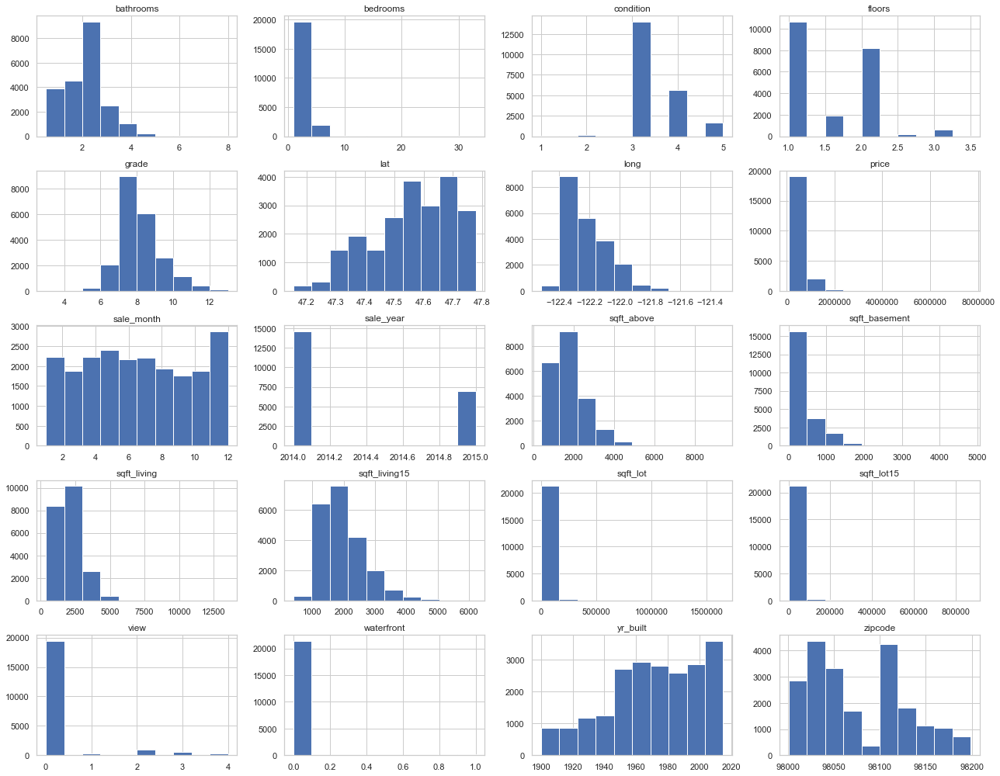

In [31]:
main_df.hist(figsize=(18, 14))
plt.tight_layout();

### Deal with outliers

removing anything above 95% or below 5% quantile 

In [32]:
rm_outliers_df = main_df.copy()

In [33]:
# (df['bedrooms'] > df['bedrooms'].quantile(.95)).sum() # cut off for outliers
outliers = ['sqft_lot', 'sqft_living15', 'sqft_living', 'sqft_basement', 'sqft_above', 'bedrooms', 'bathrooms']
for col in outliers:
    rm_outliers_df = rm_outliers_df[rm_outliers_df[col].between(
        rm_outliers_df[col].quantile(.01), rm_outliers_df[col].quantile(.99))].copy()

In [34]:
score_keeper.evaluate_model("dropped top 1% and bottom 1%", rm_outliers_df)

,Description,"RMSE (training, test)","R-squared (training, test)","Adjusted R-squared (training, test)",5-Fold Cross Validation
0,baseline,"(162685.677, 167548.548)","(0.805, 0.808)","(0.804, 0.804)",-27574406619.537
1,"change dtypes, drop id and yr_renovated","(163775.020, 156823.890)","(0.813, 0.795)","(0.812, 0.791)",-26770812644.023
2,filled missing values in waterfront and view,"(159805.399, 163622.488)","(0.809, 0.807)","(0.808, 0.804)",-26372480819.904
3,using scikit imputer to fill missing values,"(156123.393, 174094.265)","(0.815, 0.790)","(0.814, 0.787)",-26372480819.904
4,dropped top 1% and bottom 1%,"(121023.330, 111457.926)","(0.809, 0.823)","(0.807, 0.819)",-14320361668.339


In [35]:
main_df = rm_outliers_df.copy()

### Split into numerical or categorical data for pre-process

In [36]:
def split_features(df, num_unique, exclude=[]):
    """Splits dataset column names into two lists

    args: 
        df (DataFrame): DataFrame to take columns from
        num_unique (int): number of unique values to split on
    returns:
        numerical_columns (list): columns with more than num_unique values
        categorical_columns (list): columns iwth less than num_unique values
    """
    # split into numerical or categorical
    numerical_columns = [column for column in df.columns if df[column].dtype !=
                         'object' and df[column].nunique() >= num_unique and column not in exclude]
    categorical_columns = [
        column for column in df.columns if df[column].nunique() < num_unique and column not in exclude]
    return numerical_columns, categorical_columns

In [37]:
numerical_columns, categorical_columns = split_features(main_df, 100, ['price'])

### Scaling

In [38]:
scaled_df = main_df.copy()

In [39]:
from sklearn.preprocessing import MinMaxScaler
min_max_scaler = MinMaxScaler()
scaled_df[numerical_columns] = min_max_scaler.fit_transform(scaled_df[numerical_columns])

In [40]:
scaled_df.head(3)

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,zipcode,lat,long,sqft_living15,sqft_lot15,sale_year,sale_month
0,221900.0,3,1.00,0.109091,0.021869,1.0,0.0,0.0,3,7,0.132492,0.00000,0.478261,98178,0.571498,0.213087,0.124601,0.011516,2014,10
1,538000.0,3,2.25,0.470130,0.029378,2.0,0.0,0.0,3,7,0.444795,0.25974,0.443478,98125,0.908959,0.161074,0.236422,0.016099,2014,12
2,180000.0,2,1.00,0.002597,0.042388,1.0,0.0,0.0,3,6,0.003155,0.00000,0.286957,98028,0.936143,0.233221,0.565495,0.017073,2015,2


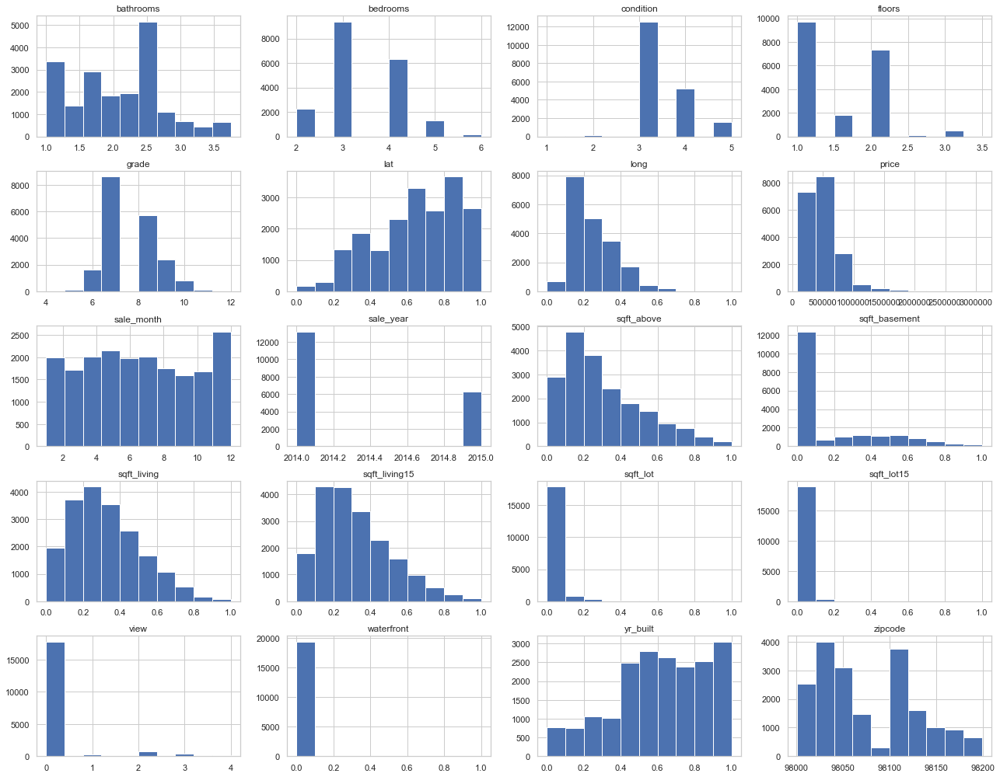

In [41]:
scaled_df.hist(figsize=(18, 14))
plt.tight_layout();

In [42]:
score_keeper.evaluate_model('scaled numerical features', scaled_df)

,Description,"RMSE (training, test)","R-squared (training, test)","Adjusted R-squared (training, test)",5-Fold Cross Validation
0,baseline,"(162685.677, 167548.548)","(0.805, 0.808)","(0.804, 0.804)",-27574406619.537
1,"change dtypes, drop id and yr_renovated","(163775.020, 156823.890)","(0.813, 0.795)","(0.812, 0.791)",-26770812644.023
2,filled missing values in waterfront and view,"(159805.399, 163622.488)","(0.809, 0.807)","(0.808, 0.804)",-26372480819.904
3,using scikit imputer to fill missing values,"(156123.393, 174094.265)","(0.815, 0.790)","(0.814, 0.787)",-26372480819.904
4,dropped top 1% and bottom 1%,"(121023.330, 111457.926)","(0.809, 0.823)","(0.807, 0.819)",-14320361668.339
5,scaled numerical features,"(118882.651, 118139.573)","(0.812, 0.812)","(0.811, 0.808)",-14320361668.379


Scaling the numerical data doesnt produce any noticeable results.

Saving the scale so we can log transform next, since we need positive values.

In [43]:
main_df = scaled_df.copy()

### Transform

In [44]:
log_transformed_df = main_df.copy()

In [45]:
# TODO write a function that identifies which feature is not normally distributed
non_normal = ['lat', 'long', 'sqft_above', 'sqft_basement', 'sqft_living', 'sqft_living15']
for feat in non_normal:
    log_transformed_df[feat] = log_transformed_df[feat].map(lambda x: np.log(x) if x > 0 else 0)
# pd.plotting.scatter_matrix(log_transformed_df, figsize=(10,12));

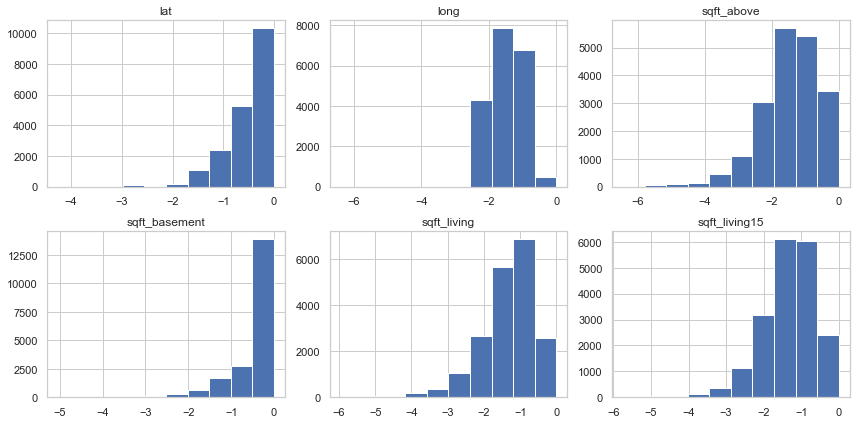

In [46]:
log_transformed_df[non_normal].hist(figsize=(12, 6), layout=(2, 3))
plt.tight_layout();

In [47]:
score_keeper.evaluate_model('used log transform on skewed distrubutions', log_transformed_df)

,Description,"RMSE (training, test)","R-squared (training, test)","Adjusted R-squared (training, test)",5-Fold Cross Validation
0,baseline,"(162685.677, 167548.548)","(0.805, 0.808)","(0.804, 0.804)",-27574406619.537
1,"change dtypes, drop id and yr_renovated","(163775.020, 156823.890)","(0.813, 0.795)","(0.812, 0.791)",-26770812644.023
2,filled missing values in waterfront and view,"(159805.399, 163622.488)","(0.809, 0.807)","(0.808, 0.804)",-26372480819.904
3,using scikit imputer to fill missing values,"(156123.393, 174094.265)","(0.815, 0.790)","(0.814, 0.787)",-26372480819.904
4,dropped top 1% and bottom 1%,"(121023.330, 111457.926)","(0.809, 0.823)","(0.807, 0.819)",-14320361668.339
5,scaled numerical features,"(118882.651, 118139.573)","(0.812, 0.812)","(0.811, 0.808)",-14320361668.379
6,used log transform on skewed distrubutions,"(127818.252, 127487.951)","(0.783, 0.778)","(0.782, 0.774)",-16614246853.857


In [48]:
score_keeper.coefs

,bathrooms,bedrooms,condition,floors,grade,id,lat,long,sale_month,sale_year,...,zipcode_98177,zipcode_98177.0,zipcode_98178,zipcode_98178.0,zipcode_98188,zipcode_98188.0,zipcode_98198,zipcode_98198.0,zipcode_98199,zipcode_98199.0
0,29122.093429,-32565.517441,23916.789740,-44217.048584,56539.001137,-6.370254e-07,332338.369824,-170792.110228,NaN,NaN,...,58721.158349,NaN,-14944.479090,NaN,-14632.089785,NaN,-33402.092222,NaN,242157.926715,NaN
1,26995.002107,-30934.603766,25053.324087,-45848.169336,56079.477474,NaN,275306.885420,-131348.504966,1745.255633,41231.291143,...,75086.286469,NaN,-3304.233756,NaN,5729.646776,NaN,-37019.333669,NaN,276425.856213,NaN
2,27538.277846,-26985.261012,23842.577166,-44457.587775,57512.299925,NaN,177852.385593,-117450.682446,1336.594218,38548.105071,...,125437.780483,NaN,8436.074606,NaN,7779.366408,NaN,-20034.796751,NaN,299014.792454,NaN
3,29996.116722,-26136.124168,24604.951047,-43401.404563,62120.286684,NaN,181626.764380,-119161.771109,1484.710485,39729.593573,...,NaN,138614.846403,NaN,14153.02474,NaN,9732.34103,NaN,-20891.574998,NaN,313684.437187
4,18713.430061,-10897.497788,27418.362504,-23301.241603,59318.809819,NaN,83948.313943,-75297.494034,830.093975,33317.431872,...,170338.575549,NaN,25618.384972,NaN,20189.921095,NaN,-4879.025930,NaN,345387.368423,NaN
5,16533.780378,-9362.279431,27736.848911,-22092.081416,58613.666425,NaN,94222.770631,-117550.473450,602.298696,29863.574413,...,128032.842625,NaN,17013.343128,NaN,9184.041808,NaN,-13864.180854,NaN,323198.998450,NaN
6,43911.031684,7487.109469,24109.051041,-10705.195571,92822.675600,NaN,38667.212262,6897.267122,1197.541809,30810.107401,...,169413.851685,NaN,13450.963532,NaN,13686.101323,NaN,-10746.426224,NaN,347814.167269,NaN


In [49]:
# main_df = log_transformed_df.copy() try and improve metrics before using log transform

### Look for correlations

In [50]:
low_corr_df = main_df.copy()

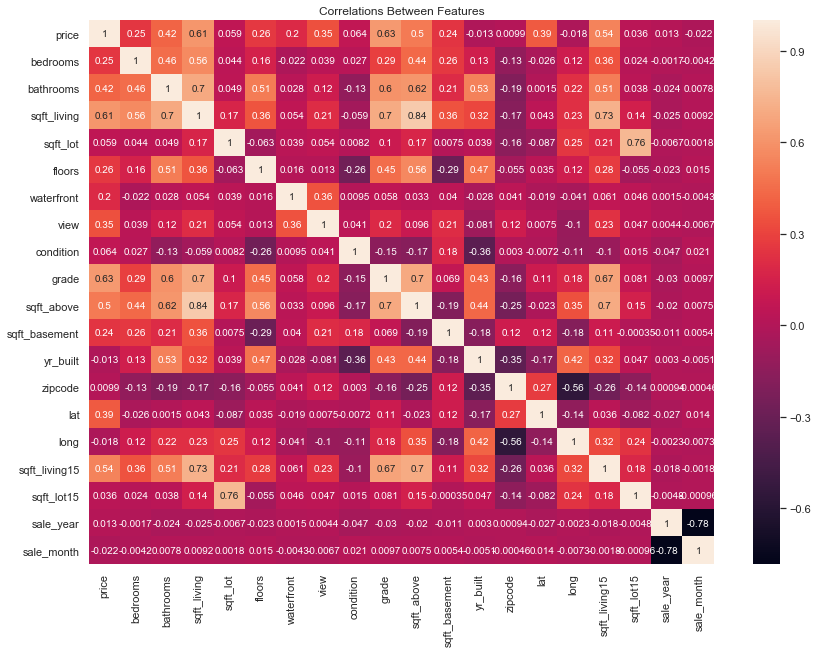

In [51]:
f = plt.figure(figsize=(14, 10))
sns.heatmap(low_corr_df.corr(), annot=True)
plt.title('Correlations Between Features');

In [52]:
# Create correlation matrix
corr_matrix = low_corr_df.corr().abs()

# Select upper triangle of correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

# Find index of feature columns with correlation greater than 0.95
to_drop = [column for column in upper.columns if any(upper[column] > 0.75)]

In [53]:
to_drop

['sqft_above', 'sqft_lot15', 'sale_month']

In [54]:
for col in to_drop[1:]:
    if col in numerical_columns:
        numerical_columns.remove(col)
    elif col in categorical_columns:
        categorical_columns.remove(col)

In [55]:
low_corr_df = low_corr_df.drop(to_drop[1:0], axis=1)

In [56]:
score_keeper.evaluate_model(f'dropped {", ".join(to_drop[1:])}', low_corr_df)

,Description,"RMSE (training, test)","R-squared (training, test)","Adjusted R-squared (training, test)",5-Fold Cross Validation
0,baseline,"(162685.677, 167548.548)","(0.805, 0.808)","(0.804, 0.804)",-27574406619.537
1,"change dtypes, drop id and yr_renovated","(163775.020, 156823.890)","(0.813, 0.795)","(0.812, 0.791)",-26770812644.023
2,filled missing values in waterfront and view,"(159805.399, 163622.488)","(0.809, 0.807)","(0.808, 0.804)",-26372480819.904
3,using scikit imputer to fill missing values,"(156123.393, 174094.265)","(0.815, 0.790)","(0.814, 0.787)",-26372480819.904
4,dropped top 1% and bottom 1%,"(121023.330, 111457.926)","(0.809, 0.823)","(0.807, 0.819)",-14320361668.339
5,scaled numerical features,"(118882.651, 118139.573)","(0.812, 0.812)","(0.811, 0.808)",-14320361668.379
6,used log transform on skewed distrubutions,"(127818.252, 127487.951)","(0.783, 0.778)","(0.782, 0.774)",-16614246853.857
7,"dropped sqft_lot15, sale_month","(117231.072, 123035.582)","(0.814, 0.805)","(0.813, 0.801)",-14320361668.379


No noticeable change when dropping sqft_living, which was highly correlated with 3 other features

In [57]:
main_df = low_corr_df.copy()

### Scatterplots of features and their relationship with price

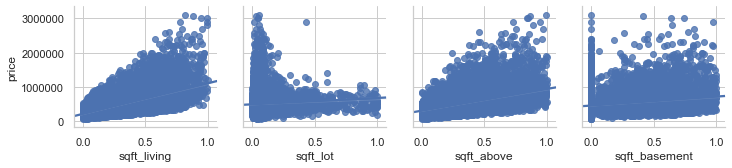

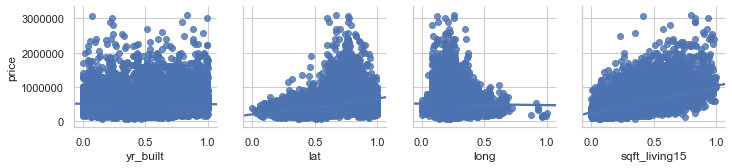

In [58]:
half_way = len(numerical_columns) // 2
sns.pairplot(x_vars=numerical_columns[:half_way], y_vars='price', data=main_df, kind='reg');
sns.pairplot(x_vars=numerical_columns[half_way:], y_vars='price', data=main_df, kind='reg');

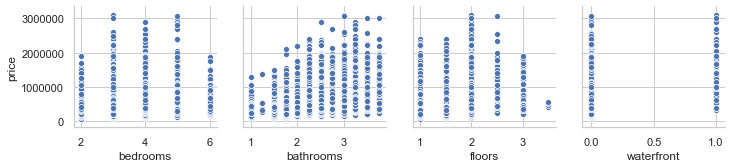

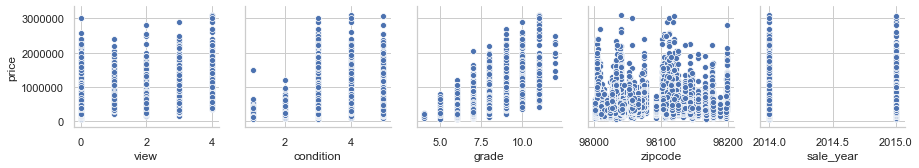

In [59]:
half_way = len(categorical_columns) // 2
sns.pairplot(x_vars=categorical_columns[:half_way], y_vars='price', data=main_df);
sns.pairplot(x_vars=categorical_columns[half_way:], y_vars='price', data=main_df);

### Binning bedrooms and bathrooms

In [60]:
bins_df = main_df.copy()

In [61]:
from sklearn.preprocessing import KBinsDiscretizer
to_bin = ['bedrooms', 'bathrooms']
bins_df[to_bin] = KBinsDiscretizer(encode='ordinal').fit_transform(bins_df[to_bin])

/Users/yrgg/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/sklearn/preprocessing/_discretization.py:193: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  'decreasing the number of bins.' % jj)
/Users/yrgg/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/sklearn/preprocessing/_discretization.py:193: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 1 are removed. Consider decreasing the number of bins.
  'decreasing the number of bins.' % jj)


In [62]:
score_keeper.evaluate_model("binned beds, bath", bins_df)

,Description,"RMSE (training, test)","R-squared (training, test)","Adjusted R-squared (training, test)",5-Fold Cross Validation
0,baseline,"(162685.677, 167548.548)","(0.805, 0.808)","(0.804, 0.804)",-27574406619.537
1,"change dtypes, drop id and yr_renovated","(163775.020, 156823.890)","(0.813, 0.795)","(0.812, 0.791)",-26770812644.023
2,filled missing values in waterfront and view,"(159805.399, 163622.488)","(0.809, 0.807)","(0.808, 0.804)",-26372480819.904
3,using scikit imputer to fill missing values,"(156123.393, 174094.265)","(0.815, 0.790)","(0.814, 0.787)",-26372480819.904
4,dropped top 1% and bottom 1%,"(121023.330, 111457.926)","(0.809, 0.823)","(0.807, 0.819)",-14320361668.339
5,scaled numerical features,"(118882.651, 118139.573)","(0.812, 0.812)","(0.811, 0.808)",-14320361668.379
6,used log transform on skewed distrubutions,"(127818.252, 127487.951)","(0.783, 0.778)","(0.782, 0.774)",-16614246853.857
7,"dropped sqft_lot15, sale_month","(117231.072, 123035.582)","(0.814, 0.805)","(0.813, 0.801)",-14320361668.379
8,"binned beds, bath","(118811.167, 119398.035)","(0.812, 0.809)","(0.811, 0.806)",-14394297651.446


There is a very small increase after binning

In [63]:
main_df = bins_df.copy()

### Using Zipcode to find City

In [64]:
city_df = main_df.copy()

In [65]:
from uszipcode import SearchEngine, SimpleZipcode
search = SearchEngine()

In [66]:
def zco(x):
    '''Take zipcode and return city'''
    city = search.by_zipcode(x).major_city
    return city if city else x

In [67]:
city_df['city'] = city_df['zipcode'].astype(int).astype(str).apply(zco)

In [68]:
city_df['city'].unique()

array(['Seattle', 'Kenmore', 'Sammamish', 'Federal Way', 'Maple Valley',
       'Duvall', 'Auburn', 'Kent', 'Redmond', 'Issaquah', 'Renton',
       'Bellevue', 'Vashon', 'Kirkland', 'Black Diamond', 'Mercer Island',
       'North Bend', 'Woodinville', 'Snoqualmie', 'Enumclaw', 'Fall City',
       'Bothell', 'Carnation', 'Medina'], dtype=object)

In [69]:
city_df['city'].nunique()

24

In [70]:
numerical_columns, categorical_columns = split_features(city_df, 100, ['price'])

In [71]:
categorical_columns.remove('zipcode')

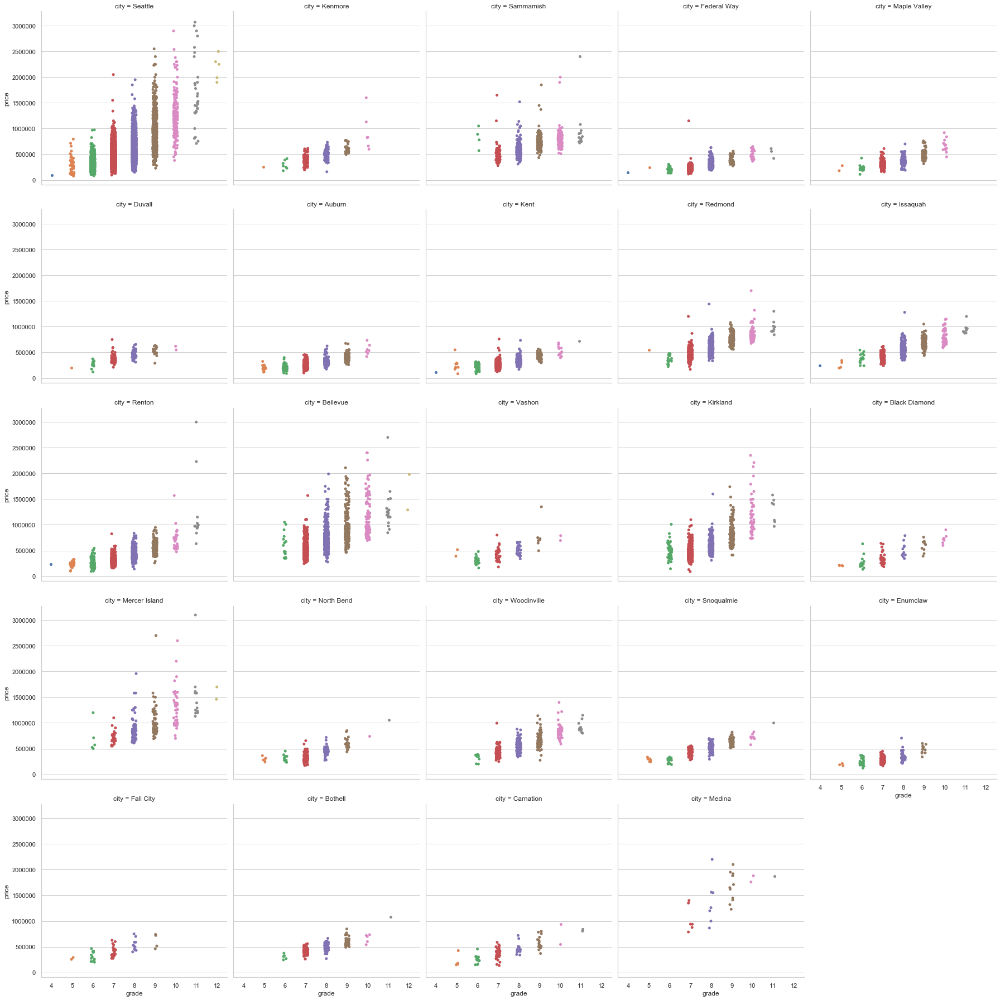

In [72]:
sns.catplot(x='grade', y='price', col='city', data=city_df, col_wrap=5);

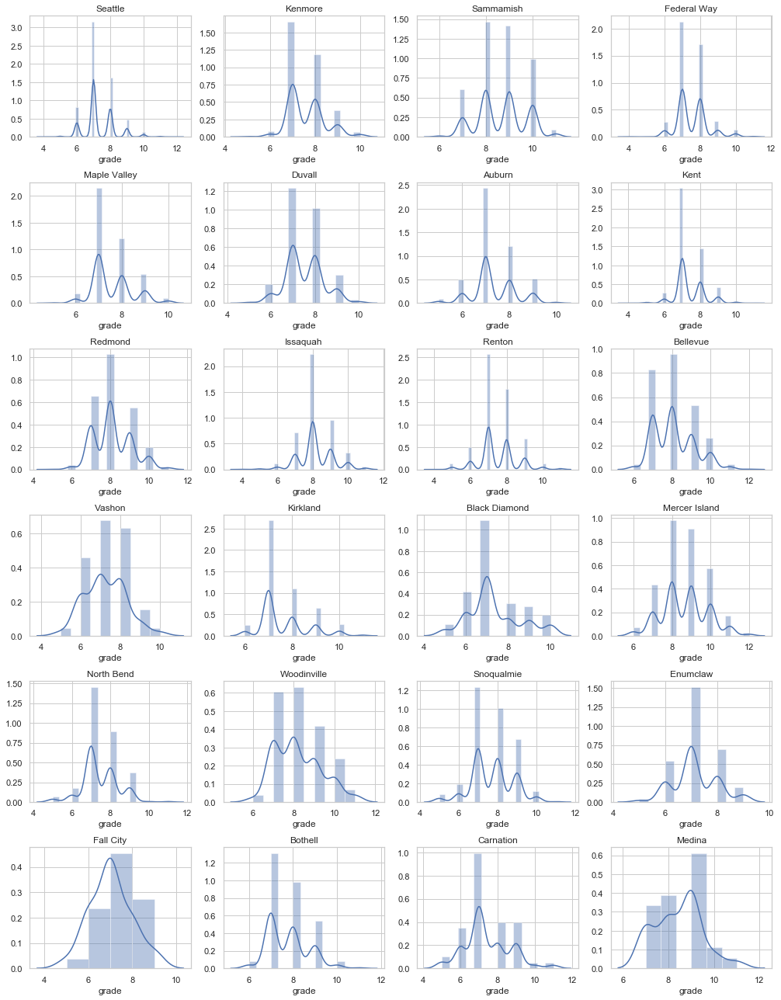

In [73]:
cities = list(city_df['city'].unique())
f, ax = plt.subplots(len(cities)//4, 4, figsize=(14, 18))
for idx, axe in enumerate(ax.flat):
    temp_df = city_df[city_df['city'] == cities[idx]]
    sns.distplot(temp_df['grade'], ax=axe)
    axe.set_title(cities[idx])
    
f.tight_layout()

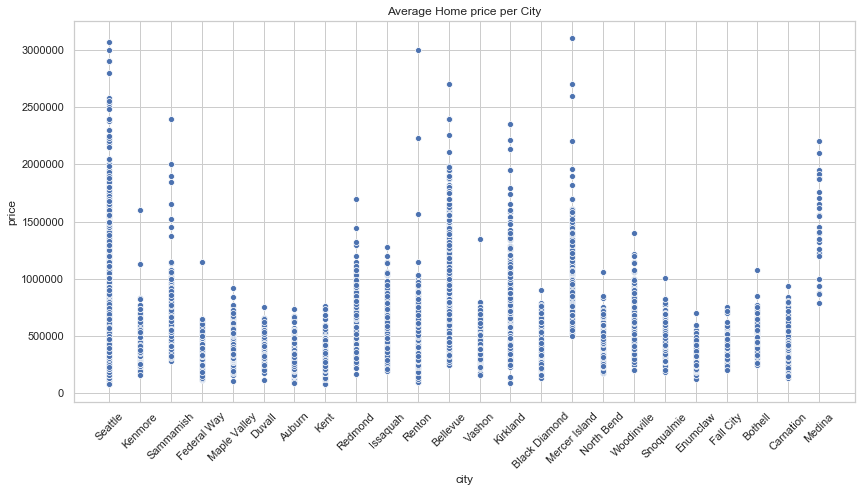

In [74]:
f = plt.figure(figsize=(14, 7))
sns.scatterplot(x='city', y='price', data=city_df)
plt.title('Average Home price per City')
plt.xticks(rotation=45);

In [75]:
score_keeper.evaluate_model('added cities using zipcode lookup', city_df, encode_dummies=['zipcode', 'city'])

,Description,"RMSE (training, test)","R-squared (training, test)","Adjusted R-squared (training, test)",5-Fold Cross Validation
0,baseline,"(162685.677, 167548.548)","(0.805, 0.808)","(0.804, 0.804)",-27574406619.537
1,"change dtypes, drop id and yr_renovated","(163775.020, 156823.890)","(0.813, 0.795)","(0.812, 0.791)",-26770812644.023
2,filled missing values in waterfront and view,"(159805.399, 163622.488)","(0.809, 0.807)","(0.808, 0.804)",-26372480819.904
3,using scikit imputer to fill missing values,"(156123.393, 174094.265)","(0.815, 0.790)","(0.814, 0.787)",-26372480819.904
4,dropped top 1% and bottom 1%,"(121023.330, 111457.926)","(0.809, 0.823)","(0.807, 0.819)",-14320361668.339
5,scaled numerical features,"(118882.651, 118139.573)","(0.812, 0.812)","(0.811, 0.808)",-14320361668.379
6,used log transform on skewed distrubutions,"(127818.252, 127487.951)","(0.783, 0.778)","(0.782, 0.774)",-16614246853.857
7,"dropped sqft_lot15, sale_month","(117231.072, 123035.582)","(0.814, 0.805)","(0.813, 0.801)",-14320361668.379
8,"binned beds, bath","(118811.167, 119398.035)","(0.812, 0.809)","(0.811, 0.806)",-14394297651.446
9,added cities using zipcode lookup,"(117579.463, 123052.201)","(0.813, 0.804)","(0.812, 0.800)",-14394275523.998


In [76]:
main_df = city_df.copy()

### Converting zipcode to mean income

In [77]:
income_df = main_df.copy()

In [78]:
def z_income(x):
    '''Take zipcode and return city'''
    city = search.by_zipcode(x).median_household_income
    return city if city else x

In [79]:
income_df['med_income'] = income_df['zipcode'].astype(int).astype(str).apply(z_income)

In [80]:
score_keeper.evaluate_model('used zipcode to lookup median income per zip', income_df, encode_dummies=[
                            'grade', 'view', 'bedrooms', 'bathrooms', 'city', 'zipcode'])

,Description,"RMSE (training, test)","R-squared (training, test)","Adjusted R-squared (training, test)",5-Fold Cross Validation
0,baseline,"(162685.677, 167548.548)","(0.805, 0.808)","(0.804, 0.804)",-27574406619.537
1,"change dtypes, drop id and yr_renovated","(163775.020, 156823.890)","(0.813, 0.795)","(0.812, 0.791)",-26770812644.023
2,filled missing values in waterfront and view,"(159805.399, 163622.488)","(0.809, 0.807)","(0.808, 0.804)",-26372480819.904
3,using scikit imputer to fill missing values,"(156123.393, 174094.265)","(0.815, 0.790)","(0.814, 0.787)",-26372480819.904
4,dropped top 1% and bottom 1%,"(121023.330, 111457.926)","(0.809, 0.823)","(0.807, 0.819)",-14320361668.339
5,scaled numerical features,"(118882.651, 118139.573)","(0.812, 0.812)","(0.811, 0.808)",-14320361668.379
6,used log transform on skewed distrubutions,"(127818.252, 127487.951)","(0.783, 0.778)","(0.782, 0.774)",-16614246853.857
7,"dropped sqft_lot15, sale_month","(117231.072, 123035.582)","(0.814, 0.805)","(0.813, 0.801)",-14320361668.379
8,"binned beds, bath","(118811.167, 119398.035)","(0.812, 0.809)","(0.811, 0.806)",-14394297651.446
9,added cities using zipcode lookup,"(117579.463, 123052.201)","(0.813, 0.804)","(0.812, 0.800)",-14394275523.998


In [195]:
coefs = score_keeper.coefs.loc[10, :].dropna().sort_values(ascending=False)

### Vizualizations:

Plot the highest three zipcodes and the lowest three zipcodes

In [198]:
coefs

grade_12         878974.570643
grade_11         424593.662044
waterfront       381887.007842
zipcode_98004    331967.875667
sqft_living      317670.488282
                     ...      
zipcode_98077   -138155.373620
zipcode_98178   -145763.959722
zipcode_98198   -152100.858780
zipcode_98155   -152212.601994
zipcode_98177   -196073.327490
Name: 10, Length: 124, dtype: float64

In [216]:
zips = {}
for key, val in coefs.items():
    if key[:-6] == 'zipcode':
        zips[key[-5:]] = val
zipcode_df = pd.DataFrame(zips.items(), columns=['zipcode', 'coef'])

In [230]:
zipcode_df

,zipcode,coef
0,98004,331967.875667
1,98105,302604.434220
2,98102,238605.084783
3,98119,222393.520136
4,98112,217789.677226
...,...,...
64,98077,-138155.373620
65,98178,-145763.959722
66,98198,-152100.858780
67,98155,-152212.601994


In [287]:
def plot_rows(df, num_rows, dest_map):
    # add a marker for every record in the filtered data, use a clustered view
    for each in df[0:num_rows].iterrows():
        folium.Marker(
            [each[1]['lat'], each[1]['long']], popup=each[1], tooltip="${:,.2f}".format(each[1]['price'])).add_to(dest_map)

In [301]:
plot_rows(df.sample(25), 25, seattle_map)

In [299]:
import folium

zips_geo = '../data/raw/zip_codes.json'

seattle_coords = (47.415338, -122.004828)

# create empty map zoomed in on San Francisco
seattle_map = folium.Map(location=seattle_coords,
                         zoom_start=9, width='80%', height='80%', left='5%', top='10%', tiles="CartoDB positron")

zipcode_overlay = folium.Choropleth(
    geo_data=zips_geo,
    name='zipcodes',
    data=zipcode_df,
    columns=['zipcode', 'coef'],
    key_on='feature.properties.ZIPCODE',
    fill_color='BuPu',
    nan_fill_color='white',
    nan_fill_opacity=.0,
    fill_opacity=0.8,
    line_opacity=0.3,
    highlight=True,
    legend_name='Impact of zipcode on model (%)'
).add_to(seattle_map)

folium.GeoJsonTooltip(fields=['ZIPCODE'], aliases=['zip:']).add_to(zipcode_overlay.geojson)

In [302]:
display(seattle_map)

In [ ]:
# graph the top 5 neighborhoods:
